# Inputs

- Info to track record about each experiment

In [2]:
date = '22-03-2021'
name = 'random-testing-morepixels800'
description = '''
We need more training data
'''

- Technical inputs

In [3]:
area = 'Strobler'
path_images = f'/home/boku/autoencoders/images/{area}/'
bands = ['Cloud','B1', 'B2', 'B3', 'B4', 'B5', 'B6', 'B7', 'B8', 'B8A', 'B9', 'B10', 'B11', 'B12']
directory = 'updated' #updated, experiment or tuning
n_pixels = 800
n_clusters = 8
n_hidden_neurons = 10
no_hazzy_images = True

- Modify in the code:
    - path test image
    - YMD test image
    - hazzy images list
    - vmin vmax colormap prediction errors

# Libraries

In [ ]:
'''Main'''
import numpy as np
import pandas as pd
import os, time, re
import pickle, gzip
from random import randint
import math
import re
import random

'''Data Viz'''
import matplotlib.pyplot as plt
from matplotlib.pyplot import hist
import matplotlib.cm as cm
import seaborn as sns
color = sns.color_palette()
import matplotlib as mpl

%matplotlib inline

'''Data Prep and Model Evaluation'''
from sklearn import preprocessing as pp
from sklearn.metrics import mean_squared_error
from sklearn.cluster import KMeans
from sklearn.neighbors import NearestNeighbors
from sklearn.model_selection import train_test_split 
from sklearn.model_selection import StratifiedKFold 
from sklearn.metrics import log_loss
from sklearn.metrics import precision_recall_curve, average_precision_score
from sklearn.metrics import roc_curve, auc, roc_auc_score
import joblib 

'''Algos'''
#import lightgbm as lgb

'''TensorFlow and Keras'''
import tensorflow as tf
import keras
from keras import backend as K
from keras.models import Sequential, Model, load_model
from keras.layers import Activation, Dense, Dropout
from keras.layers import BatchNormalization, Input, Lambda
from keras import regularizers
from keras.losses import mse, binary_crossentropy

from osgeo import gdal
from osgeo import gdal_array
import matplotlib.pyplot as plt
import numpy as np
import sys
from osgeo.gdalconst import *
import os

import math
import codecs

import osgeo #this is necessary for the type comparison in some methods
from osgeo import osr
from osgeo import ogr
from collections import defaultdict
import itertools
from osgeo import gdal_array as gdar
from osgeo import gdalconst as gdct
import glob

# Directories and info

- Directories

In [4]:
# path -- Area
area_filepath = f'/home/boku/autoencoders/codes/{directory}/{area}/'
if not os.path.exists(area_filepath):
    os.mkdir(area_filepath)

# path -- Name
filepath = f'{area_filepath}/{name}/'
if not os.path.exists(filepath):
    os.mkdir(filepath)

# path -- Models
model_filepath = os.path.join(filepath, 'Models/')
if not os.path.exists(model_filepath):
    os.mkdir(model_filepath)

# path -- Figures
figures_filepath = os.path.join(filepath, 'Figures/')
if not os.path.exists(figures_filepath):
    os.mkdir(figures_filepath)

# path -- Scalers
scalers = os.path.join(model_filepath, 'Scalers/')
if not os.path.exists(scalers):
    os.mkdir(scalers)

- Info

In [5]:
text = f'''
This folder contains the code, autoencoder models and figures resulting from the application of autoencoders in the area of {area}.

DATE: {date} (last modification)

DETAILS:
- Area of study: {area}
- Name (or objective): {name}
- Without hazzy images: {no_hazzy_images}
- Number of clusters: {n_clusters}
- Number of training pixels per cluster: {n_pixels}
- Random testing: True
- Number of hidden layers: 1
- Number of neurons in hidden layers: {n_hidden_neurons}
- Optimizer: Adam
- Learning rate: 0.01
- Activation function: linear

DESCRIPTION
{description}
'''

In [6]:
with open(f"{filepath}README.txt", "w") as file:
    file.write(text)

# Functions

In [7]:
def is_leap_year(year):
    """ if year is a leap year return True
        else return False """
    if year % 100 == 0:
        return year % 400 == 0
    return year % 4 == 0

def doy(Y,M,D):
    """ given year, month, day return day of year
        Astronomical Algorithms, Jean Meeus, 2d ed, 1998, chap 7 """
    if is_leap_year(Y):
        K = 1
    else:
        K = 2
    N = int((275 * M) / 9.0) - K * int((M + 9) / 12.0) + D - 30
    return N
def scale_MinMax (array, model_filepath, scaler_name):
    
    # Create scaler and scale
    scaler = pp.MinMaxScaler()
    array_scaled = scaler.fit_transform(array)
    
    #Create new folder and save
    mf_scaler = os.path.join(model_filepath, scaler_name)
    if not os.path.exists(mf_scaler):
        os.mkdir(mf_scaler) 
    
    joblib.dump(scaler, mf_scaler + '/scale.mod')
    
    return array_scaled

# Data from .tif images

**Train**

In [8]:
#Train
training = []
ymds = []
doys = []

files = sorted(os.listdir(path_images))
for f in files:
    if not f.startswith(('.', 'm')) and f.endswith(('.tif')) and os.path.isfile(os.path.join(path_images, f)):
       # Bands: delete cloud band and B10
        tif = gdal_array.LoadFile(path_images+f)
        if any(c in bands for c in cloud_string):
            tif = np.delete(tif, 0, axis=0)
        if 'B10' in bands:
            tif = np.delete(tif, 10, axis=0)
        
        # DOY: t1, t2
        Y_M_D = re.sub("[^0-9]", "", f)
        ymds.append(Y_M_D)
        d = doy(int(Y_M_D[-4:]),int(Y_M_D[2:4]),int(Y_M_D[:2]))
        doys.append(d)
        t1 = np.full((tif.shape[1], tif.shape[2]), (np.sin(d*2*np.pi/365)+1)/2)
        t2 = np.full((tif.shape[1], tif.shape[2]), (np.cos(d*2*np.pi/365)+1)/2)
        t1_t2 = np.stack([t1, t2], axis=0)
        
        # Join
        tif = np.concatenate([tif, t1_t2], axis=0)
        print(f'.tif shape: {tif.shape}')
        training.append(tif)

training = np.stack(training, axis = 0)

print(f'''-> Files:
{files}''')
print(f'-> Dates: {ymds}')
print(f'-> DOYs: {doys}')
print(f'-> tifArray shape: {training.shape}')

.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.tif shape: (14, 193, 354)
.

**Test**

In [9]:
#ATENCIÓN:
#Test (tiene diferente shape por eso lo hago a parte, de normal las cargaría todas juntas y después dividiría train y test)

# Bands: delete cloud band and B10
tif = gdal_array.LoadFile(f'/home/boku/autoencoders/images/{area}/Test/Strobbler_clean_Image_27082019.tif')
if any(c in bands for c in cloud_string):
    tif = np.delete(tif, 0, axis=0)
if 'B10' in bands:
    tif = np.delete(tif, 10, axis=0)

# DOY: t1, t2
Y_M_D = '27082019'
d = doy(int(Y_M_D[-4:]),int(Y_M_D[2:4]),int(Y_M_D[:2]))
print(f'DOY: {d}')
t1 = np.full((tif.shape[1], tif.shape[2]), (np.sin(d*2*np.pi/365)+1)/2)
t2 = np.full((tif.shape[1], tif.shape[2]), (np.cos(d*2*np.pi/365)+1)/2)
t1_t2 = np.stack([t1, t2], axis=0)

# Join
testing = np.concatenate([tif, t1_t2], axis=0)
testing.shape

DOY: 239


(14, 193, 354)

**Bands**

In [10]:
bands = ['B1', 'B2', 'B3', 'B4', 'B5', 'B6', 'B7', 'B8', 'B8A', 'B9', 'B11', 'B12', 't1', 't2']

# Image selection

In [11]:
if no_hazzy_images:
    # Delete images
    img_cloud = [4, 12, 17, 19, 22, 30, 34, 36, 42]
    training = np.delete(training, img_cloud, axis=0)
    shape=training.shape
    print(f'shape: {shape}')
    doys = list(np.delete(np.array(doys), img_cloud, axis = 0))
    ymds = list(np.delete(np.array(ymds), img_cloud, axis = 0))
    len(f'len doys: {doys}')
    len(f'len ymds: {ymds}')

shape: (37, 14, 193, 354)


In [12]:
193*354

68322

# Show data

**True color composite**

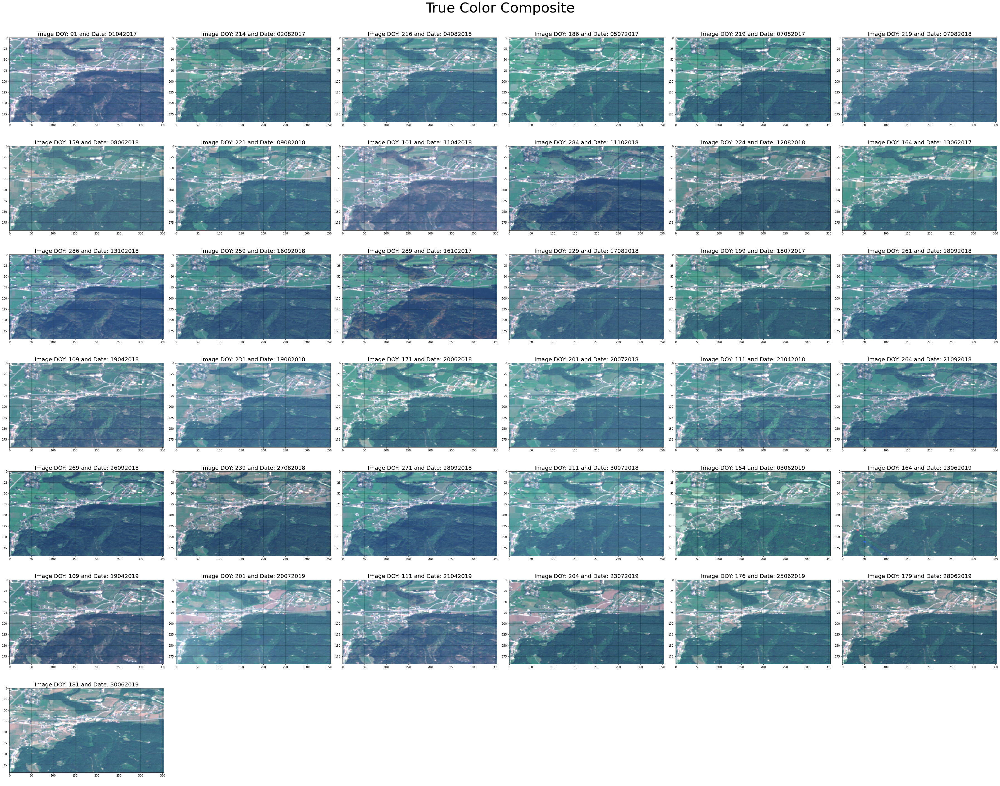

In [13]:
# Fill in number of figures:
n_figures = training.shape[0]

# Prepare subplots
n_rows = int(math.ceil((n_figures)**(1/2)))
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'True Color Composite', fontsize = 50)

# Plot images
for sp in range(n_figures):
    image = training[sp]
    img = np.dstack((image[3, ...]/1500, image[2, ...]/1500, image[1, ...]/1500))
    img = np.clip(img, 0, 1)
    ax = axs[rows[sp], columns[sp]]
    img = ax.imshow(np.array(img))
    ax.grid(color='black', linewidth=0.3)
    ax.set_title(f'Image DOY: {doys[sp]} and Date: {ymds[sp]}', fontsize=20)

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

# save
plt.tight_layout()
fig.subplots_adjust(top=0.95)
plt.savefig(f'{figures_filepath}/original_images.png', format='png', dpi=50)
plt.show()

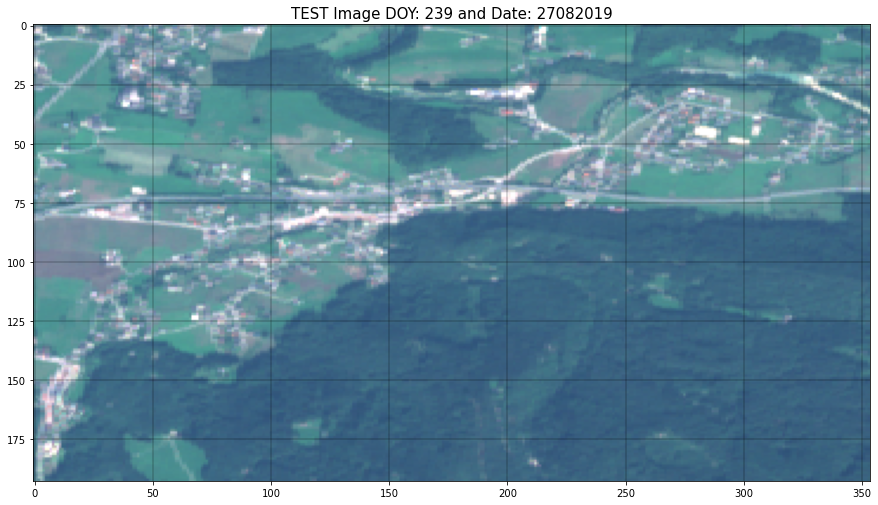

In [14]:
plt.figure(figsize = (15,15))
image = testing
img = np.dstack((image[3, ...]/1500, image[2, ...]/1500, image[1, ...]/1500))
img = np.clip(img, 0, 1)
plt.imshow(np.array(img))
plt.grid(color='black', linewidth=0.3)
plt.title(f'TEST Image DOY: {d} and Date: {Y_M_D}', fontsize=15)
plt.savefig(f'{figures_filepath}/original_images_flood.png', format='png', dpi=300)
plt.show()

**Flood Mask**

Flood Mask shape: (191, 352)


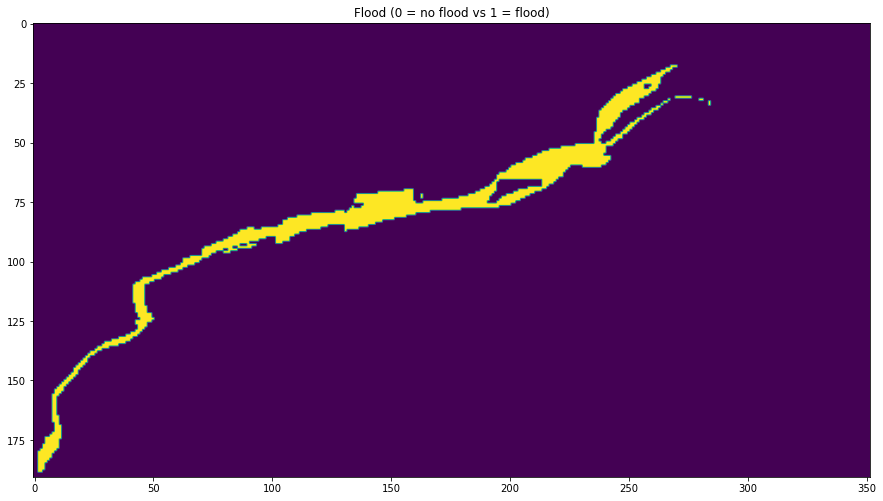

In [15]:
files = sorted(os.listdir(path_images))
for f in files:
    if not f.startswith(('.','Strobler', 'Test')) and f.endswith(('.tif')) and os.path.isfile(os.path.join(path_images, f)):
        # Labels
        flood = gdal_array.LoadFile(path_images+f)
print(f'Flood Mask shape: {flood.shape}')
plt.figure(figsize = (15,15))
plt.title ('Flood (0 = no flood vs 1 = flood)')
plt.savefig(f'{figures_filepath}/flood_mask.png', format='png', dpi=300)
plt.imshow(flood)

plt.figure(figsize = (15,15))
image = testing
img = np.dstack((image[3, ...]/1500, image[2, ...]/1500, image[1, ...]/1500))
img = np.clip(img, 0, 1)
plt.imshow(np.array(img))
plt.contour(flood==1, colors='red', linewidths=1.5)
plt.grid(color='black', linewidth=0.3)
plt.title(f'TEST Image DOY: {d} and Date: {Y_M_D}', fontsize=15)
plt.savefig(f'{figures_filepath}/original_images_floodBound.png', format='png', dpi=300)
plt.show()

# Prepare data for Clustering and AE

**CLUSTERING**

In [16]:
array_kmeans = training[:,:-2, :,:]
array_kmeans = np.transpose(array_kmeans.reshape(array_kmeans.shape[0]*array_kmeans.shape[1], array_kmeans.shape[2]*array_kmeans.shape[3]))
array_kmeans.shape

(68322, 444)

**TRAINING RESHAPED FOR AUTOENCODER**

In [17]:
# Reshape: images, bands, rows*columns
train_AE = training.reshape(training.shape[0], training.shape[1], training.shape[2]*training.shape[3])
# Join per images: bands, images*rows*columns
train_AE = np.concatenate(train_AE, axis=1)
# Transpose: images*rows*columns, bands
train_AE = train_AE.transpose()
train_AE.shape

(2527914, 14)

**TESTING RESHAPED FOR AUTOENCODER**

In [18]:
# Reshape: images, bands, rows*columns
test_AE = testing.reshape(testing.shape[0], testing.shape[1]*testing.shape[2])
# Transpose: images*rows*columns, bands
test_AE = test_AE.transpose()
test_AE.shape

(68322, 14)

# Clustering

In [19]:
# Train K-means
n_features = array_kmeans.shape[1]
print('Training the algorithm...')
start = time.time()
means = KMeans(n_clusters=n_clusters, n_init = 20, random_state = 1996).fit(array_kmeans)
end = time.time()
print(f'--- minutes ---- {(end - start)/60}')

Training the algorithm...
--- minutes ---- 0.2603267749150594


In [20]:
labels = means.labels_.reshape(training.shape[2], training.shape[3])

<Figure size 432x288 with 0 Axes>

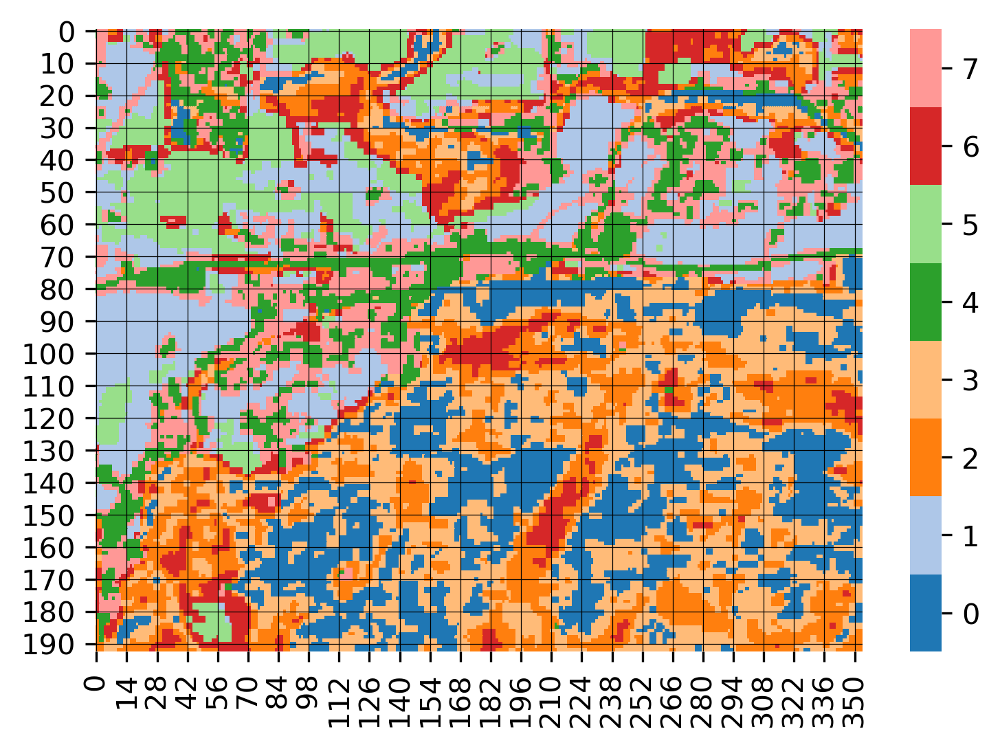

In [21]:
plt.figure()
# discrete colormap (n samples from a given cmap)
cmap = sns.color_palette('tab20', n_clusters) 
fig, ax = plt.subplots(dpi=300) 
ax = sns.heatmap(labels, cmap=cmap) 
# modify colorbar:
colorbar = ax.collections[0].colorbar 
r = colorbar.vmax - colorbar.vmin 
colorbar.set_ticks([colorbar.vmin + r / n_clusters * (0.5 + i) for i in range(n_clusters)])
colorbar.set_ticklabels(list(range(n_clusters)))
plt.grid(color='black', linewidth=0.3)
plt.savefig(f'{figures_filepath}/clusters.png', format='png', dpi=300)
plt.show()

**TRUE COLOR COMPOSITE BY CLUSTERS**

<Figure size 432x288 with 0 Axes>

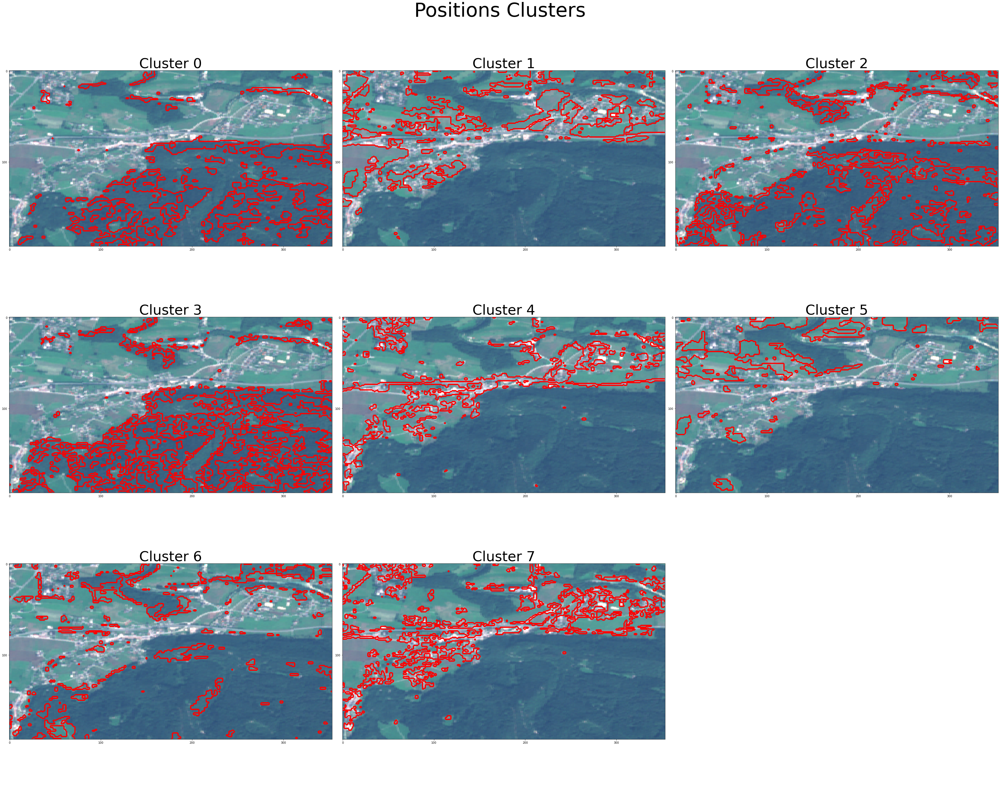

In [22]:
plt.figure()
# Prepare subplots
n_figures = n_clusters
n_rows = int(math.ceil((n_figures)**(1/2))) #add an extra row to have space for the colorbar
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'Positions Clusters', fontsize = 70)

# Pixels training positions for the cluster
for sp in range(n_figures):
    cluster = labels==sp
    ax = axs[rows[sp], columns[sp]]
    image = testing
    img = np.dstack((image[3, ...]/1500, image[2, ...]/1500, image[1, ...]/1500))
    img = np.clip(img, 0, 1)
    img = ax.imshow(img)
    ax.contour(cluster, colors='red', linewidths=1.5)
    ax.set_xticks(np.arange(cluster.shape[1]+1, step=100))
    ax.set_yticks(np.arange(cluster.shape[0]+1, step=100))
    ax.set_title(f'Cluster {sp}', fontsize=50)

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

## Tight layout, save and show
plt.tight_layout()
fig.subplots_adjust(top=0.95)
plt.savefig(f'{figures_filepath}/clusters_TCC.png', format='png', dpi=300)
plt.show()

**DIFFERENCES BETWEEN CLUSTERS**

- Function to get the positions of all pixels differenciated by their cluster

In [23]:
allClusters_pixels = []
for cluster in range(n_clusters):
    cluster = labels == cluster
    result=np.where(cluster)
    pixels = list(zip(result[0], result[1]))
    allClusters_pixels.append(pixels)
print(f'len:{len(allClusters_pixels)}')

len:8


- Get data per cluster and represent

In [ ]:
#Fill in number of figures:
n_figures = training.shape[1]

#Prepare subplots
n_rows = int(math.ceil((n_figures)**(1/2)))
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

#Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'Bands per Cluster', fontsize = 50)

##Plot random selection of pixels per band
for sp in range(n_figures):
    data = []
    label_data = []
    for cluster in range(n_clusters):
        data_cluster = []
        name = f'Cluster {cluster}'
        label_data.append(name)
        pixels = allClusters_pixels[cluster]
        for img in range(training.shape[0]):
            for pixel in pixels:
                pixel = training[img, sp, int(pixel[0]), int(pixel[1])]
                data_cluster.append(pixel)
        data.append(data_cluster)
    data = np.array(data, dtype=object)
    
    # Customize band plot
    ax = axs[rows[sp], columns[sp]]
    ax.boxplot(data.transpose())
    ax.set_title(f'Band: {bands[sp]}', fontsize=25)
    ax.set_xlabel('Cluster', fontsize=20)
    ax.set_ylabel('Reflectance', fontsize=20)
    ax.grid(True, linestyle='-.')
    ax.tick_params(labelsize=20, width=3)
    plt.sca(axs[rows[sp], columns[sp]])
    plt.xticks(list(range(1,len(label_data)+1)), label_data, rotation='vertical')

#delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

#save
plt.tight_layout()
fig.subplots_adjust(top=0.99)
plt.savefig(f'{figures_filepath}/boxplots_clusters.png', format='png', dpi=300)
plt.show()

# Get training and testing pixels

- **Training: by representativity**

Shape: (193, 354)


<Figure size 432x288 with 0 Axes>

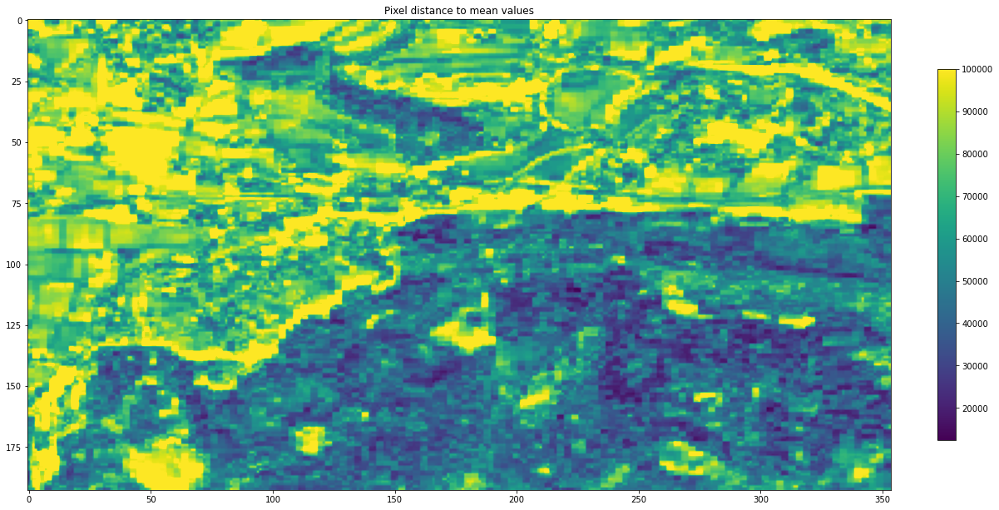

---------------------------------------------------------------------------------------
Cluster: 0
---------------------------------------------------------------------------------------
Min difference: 12415.032313860986
Pixel 0: (110, 224)
Min difference: 12415.032313860986
Pixel 1: (110, 225)
Min difference: 12661.00261461287
Pixel 2: (111, 226)
Min difference: 12910.383287642755
Pixel 3: (159, 303)
Min difference: 13894.185133409872
Pixel 4: (111, 224)
Min difference: 13894.185133409872
Pixel 5: (111, 225)
Min difference: 13989.959381530156
Pixel 6: (85, 347)
Min difference: 14318.220847695575
Pixel 7: (85, 345)
Min difference: 14318.220847695575
Pixel 8: (85, 346)
Min difference: 14894.30299055273
Pixel 9: (110, 226)
Min difference: 15273.6695319061
Pixel 10: (110, 221)
Min difference: 15273.6695319061
Pixel 11: (110, 222)
Min difference: 15313.706407943511
Pixel 12: (159, 304)
Min difference: 15313.706407943511
Pixel 13: (159, 305)
Min difference: 15509.121445537494
Pixel 14: (16

In [24]:
plt.figure()
# reshape to only bands
band_axis = np.concatenate(training, axis=0)

# calculate sum of the difference per pixel to the mean of each band in its cluster
represent = []
for c in range(n_clusters):
    # select cluster
    cluster = band_axis*(labels == c)
    # difference to the mean per band
    diff_bands = []
    for b in cluster:
        diff = abs(b - np.full((training.shape[2], training.shape[3]), (np.sum(b)/np.count_nonzero(b)))*(labels == c))
        diff_bands.append(diff)
    diff_bands = np.array(diff_bands)

    # sum of the differences for all bands
    cluster_diff_bands = np.sum(diff_bands, axis=0)
    represent.append(cluster_diff_bands)

# Join all clusters for representation
represent = np.sum(np.array(represent), axis=0)
print(f'Shape: {represent.shape}')

# represent values
plt.figure(figsize=(20,20))
plt.imshow(represent, vmax=100000)
plt.title('Pixel distance to mean values')
plt.colorbar(fraction=0.02)
plt.savefig(f'{figures_filepath}/pixel_representativity.png', format='png', dpi=300)
plt.show()

# select most representative pixels
n_pixels = n_pixels
rep_pix_allCluster = []
for c in range(n_clusters):
    cluster = represent*(labels == c)
    print('---------------------------------------------------------------------------------------')
    print(f'Cluster: {c}')
    print('---------------------------------------------------------------------------------------')
    rep_pix_cluster = []
    for i in range(n_pixels):
        minval = np.nanmin(cluster[np.nonzero(cluster)])
        print(f'Min difference: {minval}')
        pixel = [(ix,iy) for ix, row in enumerate(cluster) for iy, i in enumerate(row) if i == minval][0]
        rep_pix_cluster.append(pixel)
        print(f'Pixel {i}: {pixel}')
        cluster[pixel[0]][pixel [1]] = 0
    print(f'Pixel Locations: {rep_pix_cluster}')
    rep_pix_allCluster.append(rep_pix_cluster)

- **Testing: random**

In [25]:
n_pixels = n_pixels
rand_pix_allCluster = []
for c in range(n_clusters):
    cluster = labels == c
    print('---------------------------------------------------------------------------------------')
    print(f'Cluster: {c}')
    print('---------------------------------------------------------------------------------------')
    rand_pix_cluster = []
    for i in range(n_pixels):
        pixel = tuple(random.choice(allClusters_pixels[c]))
        rand_pix_cluster.append(pixel)
        print(f'Pixel {i}: {pixel}')
    print(f'Pixel Locations: {rand_pix_cluster}')
    rand_pix_allCluster.append(rand_pix_cluster)

---------------------------------------------------------------------------------------
Cluster: 0
---------------------------------------------------------------------------------------
Pixel 0: (7, 155)
Pixel 1: (140, 196)
Pixel 2: (128, 201)
Pixel 3: (84, 219)
Pixel 4: (192, 161)
Pixel 5: (144, 200)
Pixel 6: (20, 312)
Pixel 7: (187, 126)
Pixel 8: (80, 193)
Pixel 9: (146, 166)
Pixel 10: (155, 85)
Pixel 11: (174, 313)
Pixel 12: (141, 336)
Pixel 13: (99, 158)
Pixel 14: (133, 280)
Pixel 15: (144, 335)
Pixel 16: (153, 95)
Pixel 17: (161, 192)
Pixel 18: (141, 80)
Pixel 19: (104, 254)
Pixel 20: (80, 208)
Pixel 21: (182, 151)
Pixel 22: (146, 196)
Pixel 23: (133, 273)
Pixel 24: (114, 148)
Pixel 25: (79, 232)
Pixel 26: (143, 62)
Pixel 27: (180, 143)
Pixel 28: (165, 344)
Pixel 29: (134, 264)
Pixel 30: (85, 288)
Pixel 31: (142, 282)
Pixel 32: (132, 173)
Pixel 33: (176, 318)
Pixel 34: (168, 98)
Pixel 35: (167, 248)
Pixel 36: (25, 163)
Pixel 37: (159, 103)
Pixel 38: (155, 119)
Pixel 39: (126, 344

**SHOW TRAINING AND TESTING POSITIONS IN MAP**

<Figure size 432x288 with 0 Axes>

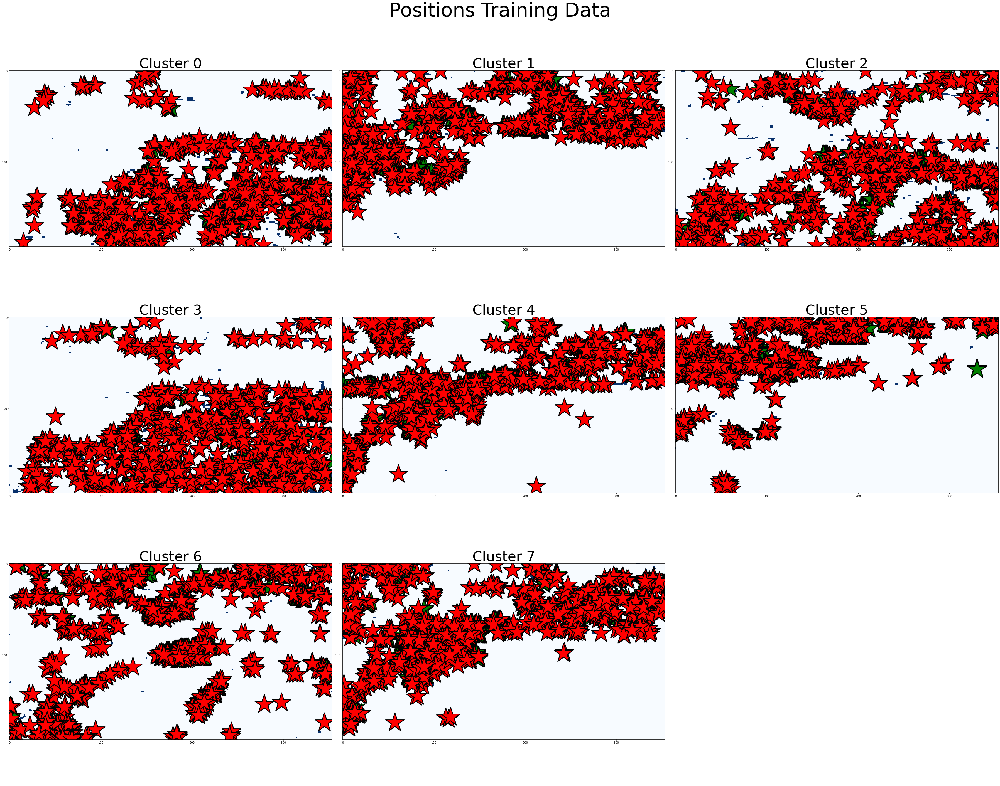

In [26]:
plt.figure()
# Prepare subplots
n_figures = n_clusters
n_rows = int(math.ceil((n_figures)**(1/2))) #add an extra row to have space for the colorbar
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'Positions Training Data', fontsize = 70)

# Pixels training positions for the cluster
for sp in range(n_figures):
    cluster = labels==sp
    ax = axs[rows[sp], columns[sp]]
    img = ax.imshow(cluster, cmap='Blues', interpolation='nearest')
    for pixel in rep_pix_allCluster[sp]:
        ax.scatter(pixel[1], pixel[0],color = 'green', marker='*', s=5000, edgecolor='black', linewidth=3)
    for pixel in rand_pix_allCluster[sp]:
        ax.scatter(pixel[1], pixel[0],color = 'red', marker='*', s=5000, edgecolor='black', linewidth=3)
    ax.set_xticks(np.arange(cluster.shape[1]+1, step=100))
    ax.set_xticks(np.arange(cluster.shape[1]+1, step=100))
    ax.set_yticks(np.arange(cluster.shape[0]+1, step=100))
    ax.set_title(f'Cluster {sp}', fontsize=50)

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

## Tight layout, save and show
plt.tight_layout()
fig.subplots_adjust(top=0.95)
plt.savefig(f'{figures_filepath}/training_pixel_positions.png', format='png', dpi=300)
plt.show()

**GET PIXEL TRAINING DATA**

In [27]:
pixel_training = []
for b in range(len(bands)):
    data = []
    label_data = []
    for cluster in range(n_clusters):
        data_cluster = []
        name = f'Cluster {cluster}'
        label_data.append(name)
        pixels = rep_pix_allCluster[cluster]
        for img in range(training.shape[0]):
            for pixel in pixels:
                pixel = training[img, b, pixel[0], pixel[1]]
                data_cluster.append(pixel)
        data.append(data_cluster)
    pixel_training.append(data)
pixel_training = np.array(pixel_training)
print('bands, clusters, images x pixels')
print(pixel_training.shape)

bands, clusters, images x pixels
(14, 8, 29600)


**SHOW TRAINING DATA: BOXPLOTS**

<Figure size 432x288 with 0 Axes>

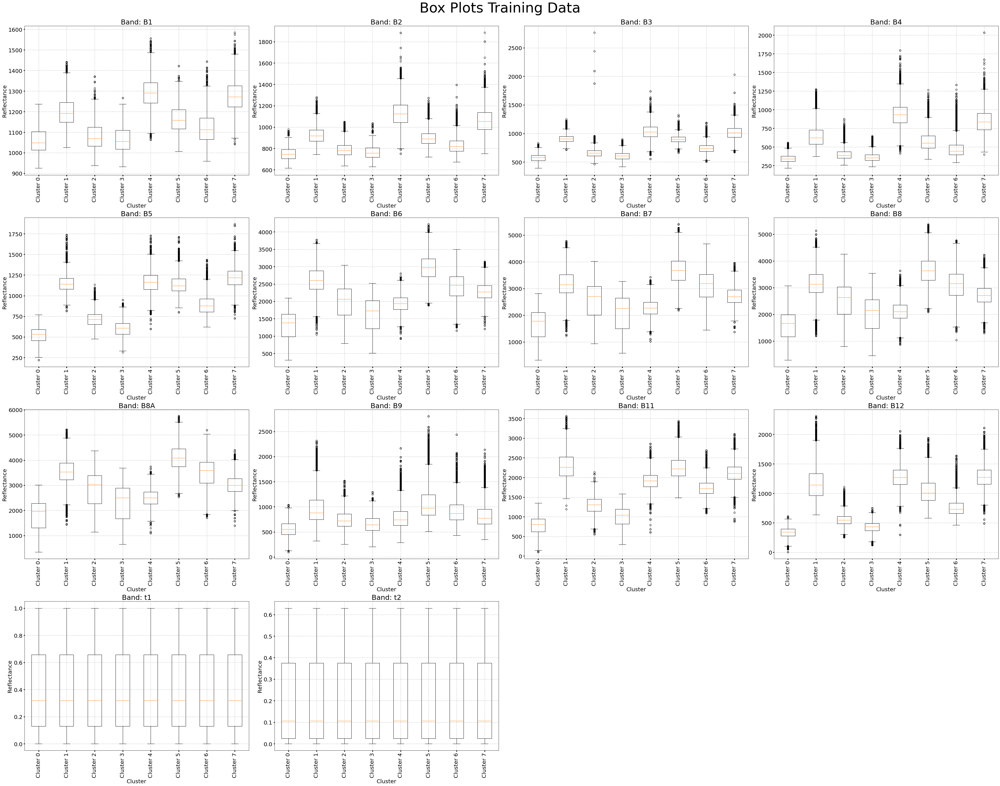

In [28]:
plt.figure()

# Prepare subplots
n_figures = len(bands)
n_rows = int(math.ceil((n_figures)**(1/2)))
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'Box Plots Training Data', fontsize = 50)

# Represent Data
for sp in range(n_figures):     
    data = pixel_training[sp]
    ax = axs[rows[sp], columns[sp]]
    ax.boxplot(data.transpose())
    ax.set_title(f'Band: {bands[sp]}', fontsize=25)
    ax.set_xlabel('Cluster', fontsize=20)
    ax.set_ylabel('Reflectance', fontsize=20)
    ax.grid(True, linestyle='-.')
    ax.tick_params(labelsize=20, width=3)
    plt.sca(axs[rows[sp], columns[sp]])
    plt.xticks(list(range(1,len(label_data)+1)), label_data, rotation='vertical')

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

## Tight layout, save and show
plt.tight_layout()
fig.subplots_adjust(top=0.95)
plt.savefig(f'{figures_filepath}/boxplots_training.png', format='png', dpi=300)
plt.show()

**SHOW TRAINING DATA: BANDS**

<Figure size 432x288 with 0 Axes>

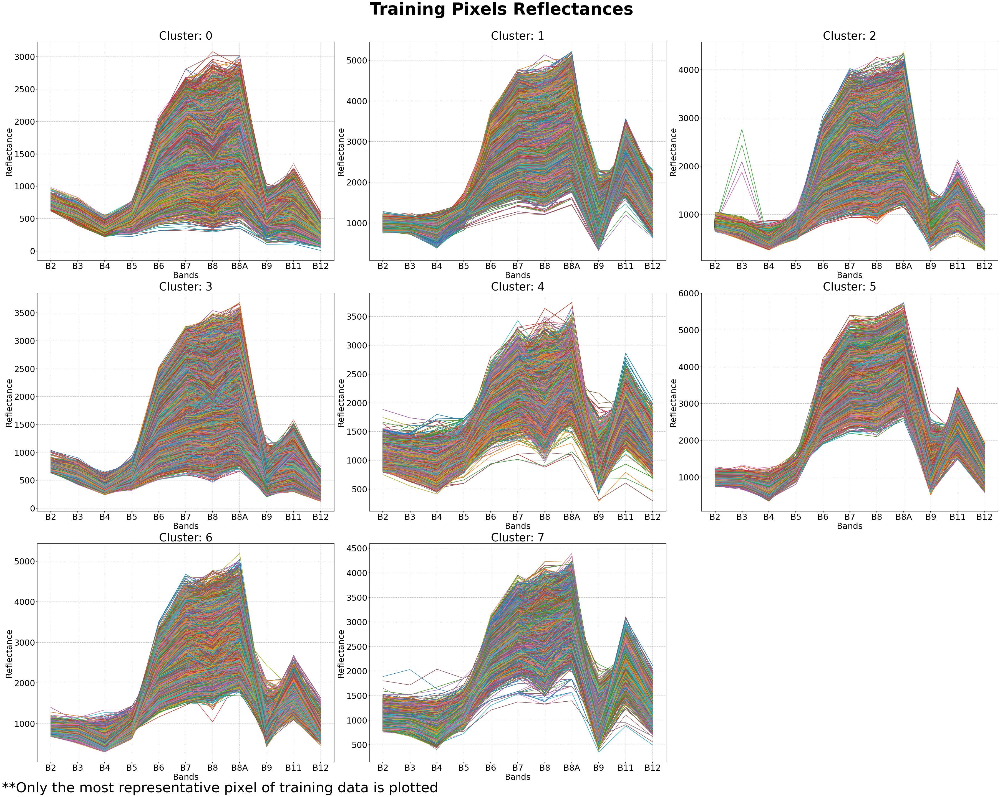

In [29]:
plt.figure()

# Prepare subplots
n_figures = n_clusters
n_rows = int(math.ceil((n_figures)**(1/2))) 
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
fig.suptitle(f'Training Pixels Reflectances', fontsize = 60, fontweight="bold")

# Represent Data
for sp in range(n_figures):     
    data = pixel_training[1:-2,sp,:]
    ax = axs[rows[sp], columns[sp]]
    ax.plot(data)
    ax.set_title(f'Cluster: {sp}', fontsize=40)
    ax.set_xlabel('Bands', fontsize=30)
    ax.set_ylabel('Reflectance', fontsize=30)
    ax.grid(True, linestyle='-.')
    ax.tick_params(labelsize=30, width=3)
    ax.set_xticks(range(data.shape[0]))
    ax.set_xticklabels(bands[1:-2]);

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

# add a comment
textstr = '**Only the most representative pixel of training data is plotted'
plt.gcf().text(0, -0.01, textstr, fontsize=50)

## Tight layout, save and show
plt.tight_layout()
fig.subplots_adjust(top=0.93)
plt.savefig(f'{figures_filepath}/bandsShape_training.png', format='png', dpi=300)
plt.show()

**SHOW TRAINING DATA: BANDS ALONG TIME**

In [32]:
'''plt.figure()

# Prepare subplots
n_figures = n_clusters
n_rows = int(math.ceil((n_figures)**(1/2)))
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (40,60))
fig.suptitle(f'Training Pixels Reflectances along time', fontsize = 60, fontweight="bold")

# Represent Data

for sp in range(n_figures):     
    data = np.transpose(pixel_training[:-2,sp,:])
    ax = axs[rows[sp], columns[sp]]
    im = ax.plot(data)
    ax.set_title(f'Cluster: {sp}', fontsize=40)
    ax.set_xlabel('DOY', fontsize=30)
    ax.set_ylabel('Reflectance', fontsize=30)
    ax.grid(True, linestyle='-.')
    ax.tick_params(labelsize=20, width=3)
    ax.set_xticks(range(data.shape[0]))
    #ax.set_xticklabels(doys, rotation=90);

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()
    
# legend
leg = plt.legend(im, bands[:-2], loc=4, fontsize = 40)

# add a comment
textstr = '**Only the most representative pixel of the training data is plotted'
plt.gcf().text(0, -0.01, textstr, fontsize=50)

## Tight layout, save and show
plt.tight_layout()
fig.subplots_adjust(top=0.93)
plt.savefig(f'{figures_filepath}/bandsShapeAlongTime_training.png', format='png', dpi=300)
plt.show()'''

'plt.figure()\n\n# Prepare subplots\nn_figures = n_clusters\nn_rows = int(math.ceil((n_figures)**(1/2)))\nn_cols = int(math.ceil(n_figures/n_rows))\nrows=[]\ncolumns = []\nfor row in range(n_rows):\n    for col in range(n_cols):\n        rows.append(row)\n        columns.append(col)\n\n# Subplots and figure title\nfig, axs = plt.subplots(n_rows, n_cols, figsize= (40,60))\nfig.suptitle(f\'Training Pixels Reflectances along time\', fontsize = 60, fontweight="bold")\n\n# Represent Data\n\nfor sp in range(n_figures):     \n    data = np.transpose(pixel_training[:-2,sp,:])\n    ax = axs[rows[sp], columns[sp]]\n    im = ax.plot(data)\n    ax.set_title(f\'Cluster: {sp}\', fontsize=40)\n    ax.set_xlabel(\'DOY\', fontsize=30)\n    ax.set_ylabel(\'Reflectance\', fontsize=30)\n    ax.grid(True, linestyle=\'-.\')\n    ax.tick_params(labelsize=20, width=3)\n    ax.set_xticks(range(data.shape[0]))\n    #ax.set_xticklabels(doys, rotation=90);\n\n# delete empty figures\nfor image in range(n_figures, 

**GET TESTING DATA**

In [30]:
pixel_testing = []
for b in range(len(bands)):
    data = []
    for cluster in range(n_clusters):
        data_cluster = []
        pixels = rand_pix_allCluster[cluster]
        for img in range(training.shape[0]):
            for pixel in pixels:
                pixel = training[img, b, pixel[0], pixel[1]]
                data_cluster.append(pixel)
        data.append(data_cluster)
    pixel_testing.append(data)
pixel_testing = np.array(pixel_testing)
print('bands, clusters, images x pixels')
print(pixel_testing.shape)

bands, clusters, images x pixels
(14, 8, 29600)


# Scale each pixel

- Training pixels: generate scaler and transform

In [33]:
scaler = pp.MinMaxScaler()

pixel_trainingScaled = []    
    
for cluster in range(n_clusters):
    pixel_training_cluster = np.transpose(pixel_training[:, cluster, :]) #images x bands
    pixel_trainingScaled_cluster = scaler.fit_transform(pixel_training_cluster)
    scalers_cluster = os.path.join(model_filepath, f'Scalers/Scaler_{cluster}')
    if not os.path.exists(scalers_cluster):
        os.mkdir(scalers_cluster)
    joblib.dump(scaler, scalers + f'/Scaler_{cluster}/' + '/scale.mod')
    pixel_trainingScaled.append(pixel_trainingScaled_cluster)
    
pixel_trainingScaled = np.array(pixel_trainingScaled)
pixel_trainingScaled.shape # clusters x images x bands

(8, 29600, 14)

- Testing pixels: transform

In [34]:
pixel_testingScaled = []    
    
for cluster in range(n_clusters):
    scaler_cluster = joblib.load(scalers + f'/Scaler_{cluster}/scale.mod')
    pixel_testing_cluster = np.transpose(pixel_testing[:, cluster, :]) #images x bands
    pixel_testingScaled_cluster = scaler_cluster.transform(pixel_testing_cluster)
    pixel_testingScaled.append(pixel_testingScaled_cluster)
    
pixel_testingScaled = np.array(pixel_testingScaled)
pixel_testingScaled.shape # clusters x images x bands

(8, 29600, 14)

---------------------------------------------------------------------------------------------------------

# Autoencoder

-------------------------------------------------------------------------------------------
                                    CLUSTER 0 --- AUTOENCODER 0
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00014: early stopping
Min error: 0.00013235706137493253
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_0/assets


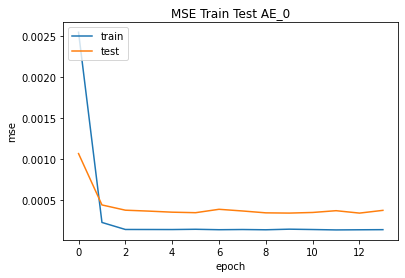

Epoch 00014: early stopping
Min error: 0.0001315078989136964
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_0/assets


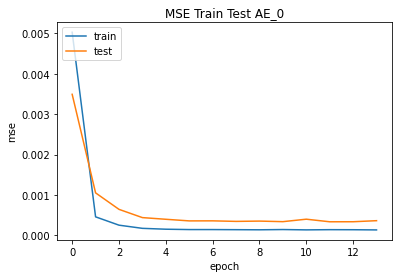

Epoch 00014: early stopping
Min error: 0.00013243821740616113
Epoch 00014: early stopping
Min error: 0.00013182325346861035
Epoch 00014: early stopping
Min error: 0.0001333323452854529
Epoch 00014: early stopping
Min error: 0.00013277881953399628
-------------------------------------------------------------------------------------------
                                    CLUSTER 1 --- AUTOENCODER 1
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00014: early stopping
Min error: 0.0001605351862963289
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_1/assets


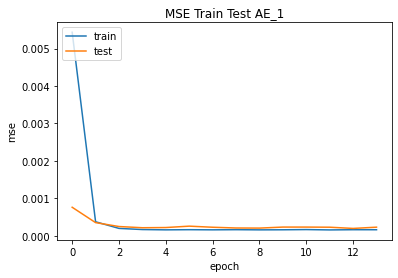

Epoch 00014: early stopping
Min error: 0.00016032671555876732
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_1/assets


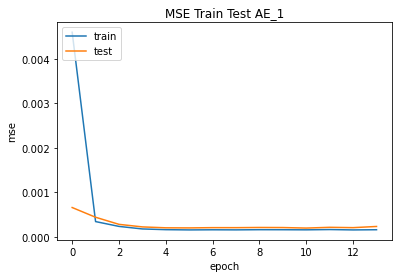

Epoch 00014: early stopping
Min error: 0.00016074816812761128
Epoch 00014: early stopping
Min error: 0.0001626702432986349
Epoch 00014: early stopping
Min error: 0.00016025063814595342
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_1/assets


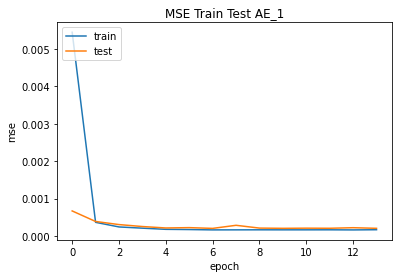

Epoch 00014: early stopping
Min error: 0.00016153349133674055
-------------------------------------------------------------------------------------------
                                    CLUSTER 2 --- AUTOENCODER 2
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00014: early stopping
Min error: 0.0001155672871391289
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_2/assets


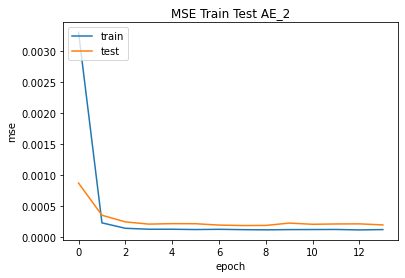

Epoch 00014: early stopping
Min error: 0.00011788038682425395
Epoch 00014: early stopping
Min error: 0.00011668718798318878
Epoch 00014: early stopping
Min error: 0.00011784664093283936
Epoch 00014: early stopping
Min error: 0.0001161515829153359
Epoch 00014: early stopping
Min error: 0.00011621067096712068
-------------------------------------------------------------------------------------------
                                    CLUSTER 3 --- AUTOENCODER 3
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00014: early stopping
Min error: 0.00012813902867492288
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_3/assets


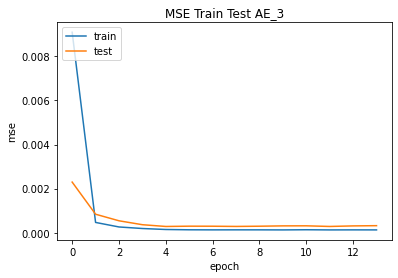

Epoch 00014: early stopping
Min error: 0.00012823154975194484
Epoch 00014: early stopping
Min error: 0.00012925095506943762
Epoch 00014: early stopping
Min error: 0.00012989489187020808
Epoch 00014: early stopping
Min error: 0.00012665790563914925
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_3/assets


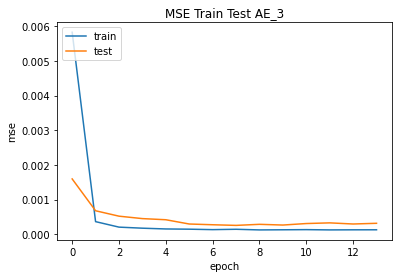

Epoch 00014: early stopping
Min error: 0.00012683427485171705
-------------------------------------------------------------------------------------------
                                    CLUSTER 4 --- AUTOENCODER 4
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00014: early stopping
Min error: 0.00031849020160734653
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_4/assets


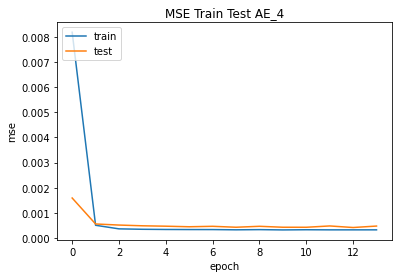

Epoch 00014: early stopping
Min error: 0.00031986855901777744
Epoch 00014: early stopping
Min error: 0.0003163011569995433
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_4/assets


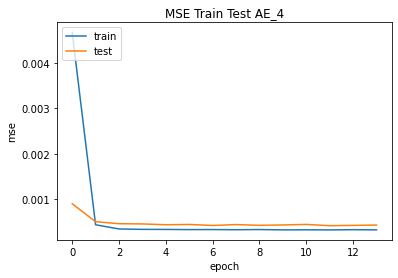

Epoch 00014: early stopping
Min error: 0.00031942318310029805
Epoch 00014: early stopping
Min error: 0.0003266520507168025
Epoch 00014: early stopping
Min error: 0.0003176582686137408
-------------------------------------------------------------------------------------------
                                    CLUSTER 5 --- AUTOENCODER 5
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00014: early stopping
Min error: 0.0001599529932718724
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_5/assets


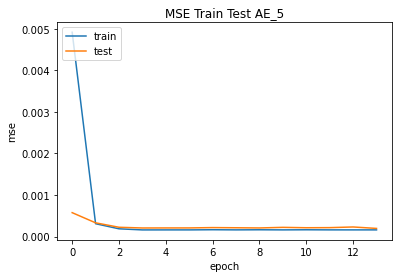

Epoch 00014: early stopping
Min error: 0.00015940549201332033
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_5/assets


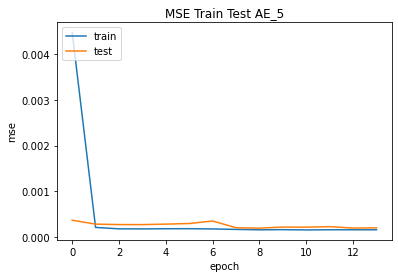

Epoch 00014: early stopping
Min error: 0.00016099971253424883
Epoch 00014: early stopping
Min error: 0.00016081213834695518
Epoch 00014: early stopping
Min error: 0.00015683502715546638
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_5/assets


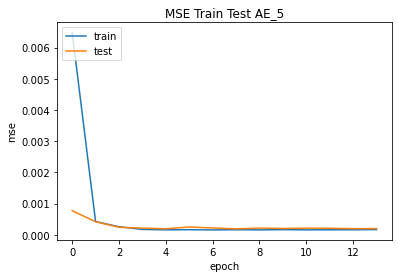

Epoch 00014: early stopping
Min error: 0.00015357945812866092
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_5/assets


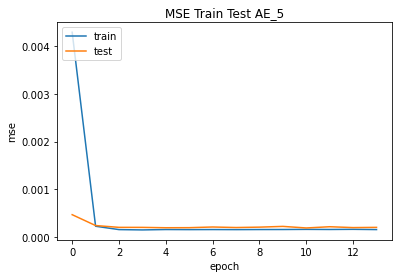

-------------------------------------------------------------------------------------------
                                    CLUSTER 6 --- AUTOENCODER 6
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00014: early stopping
Min error: 0.0001856630260590464
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_6/assets


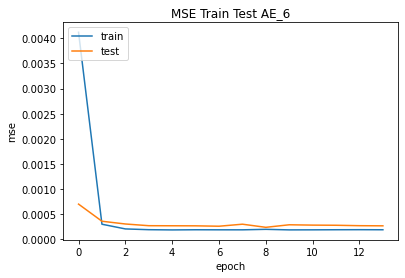

Epoch 00014: early stopping
Min error: 0.00018545392958912998
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_6/assets


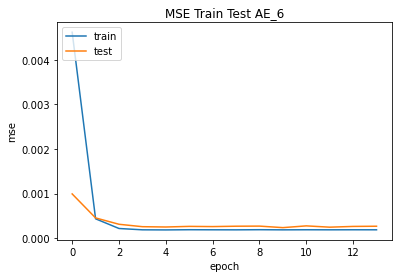

Epoch 00014: early stopping
Min error: 0.00018484918109606951
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_6/assets


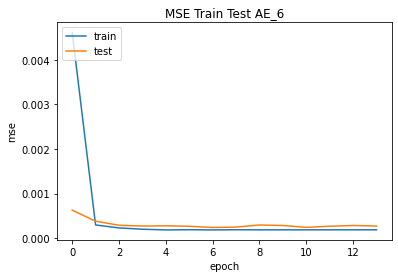

Epoch 00014: early stopping
Min error: 0.00018574779096525162
Epoch 00014: early stopping
Min error: 0.00018394834478385746
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_6/assets


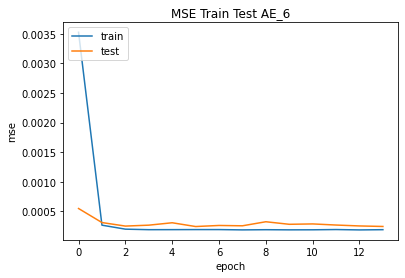

Epoch 00014: early stopping
Min error: 0.0001849638792918995
-------------------------------------------------------------------------------------------
                                    CLUSTER 7 --- AUTOENCODER 7
    ------------------------------------------------------------------------------------------------------
Preparing training data...
Training the model...
Epoch 00014: early stopping
Min error: 0.0002543197479099035
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_7/assets


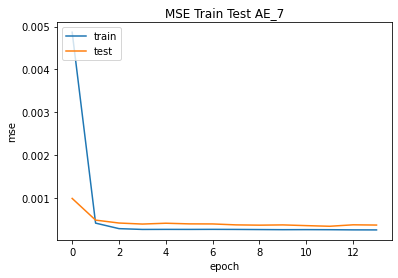

Epoch 00014: early stopping
Min error: 0.0002475147193763405
INFO:tensorflow:Assets written to: /home/boku/autoencoders/codes/updated/Strobler/random-testing-morepixels800/Models/Autoencoder_7/assets


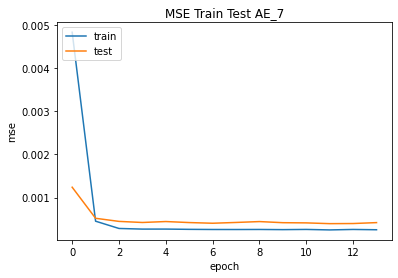

Epoch 00014: early stopping
Min error: 0.00025138500495813787
Epoch 00014: early stopping
Min error: 0.0002484059950802475
Epoch 00014: early stopping
Min error: 0.0002504502481315285
Epoch 00014: early stopping
Min error: 0.00024864712031558156
Running time AEs --- minutes ----17.837945302327473


In [35]:
# early stopping
es = keras.callbacks.EarlyStopping(monitor = 'mse', mode = 'min', min_delta = 0.001, verbose = 2, patience = 12) 

start = time.time()

for ae in range(n_clusters):

    lowest_error = 100000000

    print(f'''-------------------------------------------------------------------------------------------
                                    CLUSTER {ae} --- AUTOENCODER {ae}
    ------------------------------------------------------------------------------------------------------''')

    ## Create a folder for the AE
    # Model filepaths
    folder = f'Autoencoder_{ae}'
    mf = os.path.join(model_filepath, folder)
    if not os.path.exists(mf):
          os.mkdir(mf)
    # Figures filepaths
    mf2 = os.path.join(figures_filepath, 'Training')
    if not os.path.exists(mf2):
          os.mkdir(mf2)
    mf3 = os.path.join(figures_filepath, 'Error')
    if not os.path.exists(mf3):
          os.mkdir(mf3)
    mf4 = os.path.join(figures_filepath, 'Reflectance')
    if not os.path.exists(mf4):
          os.mkdir(mf4)


    ## Prepare training data
    print('Preparing training data...')

    
    # Data of the selected pixels
    pixel_trainingScaled_cluster = pixel_trainingScaled[ae]
    pixel_testingScaled_cluster = pixel_testingScaled[ae]


    ## Train AE
    print('Training the model...')
    for n in range(6):
        # Create model
        model = Sequential()

        # Create layers
        model.add(Dense(units=n_hidden_neurons, activation='linear', input_dim=len(bands)))
        model.add(Dense(units=len(bands), activation='linear'))

        # Compile model (a traditional default value for the learning rate is 0.1 or 0.01)
        opt = keras.optimizers.Adam(learning_rate=0.01)
        tf.keras.losses.MeanSquaredError(reduction="auto", name="mean_squared_error")
        model.compile(optimizer=opt, loss="mean_squared_error", metrics=['mse'])

        # Train
        X_train = pixel_trainingScaled_cluster
        X_test = pixel_testingScaled_cluster
        history = model.fit(x=X_train, y=X_train,
                            epochs=200,
                            batch_size= None,
                            shuffle=True,
                            validation_data=(X_test,X_test),
                            verbose=0,
                            callbacks=[es])

        # Save best model
        error = min(history.history['mse'])
        print(f'Min error: {error}')

        if error < lowest_error:
            lowest_error = error
            model.save(mf, overwrite=True, include_optimizer=True)
            # Plot train-test curves
            plt.plot(history.history['mse'])
            plt.plot(history.history['val_mse'])
            plt.title(f'MSE Train Test AE_{ae}')
            plt.ylabel('mse')
            plt.xlabel('epoch')
            plt.legend(['train', 'test'], loc='upper left')
            plt.savefig(f'{mf2}/traintestCurvesAE_{ae}.png', format='png', dpi=300)
            plt.show()
        pass

end = time.time()

print(f'Running time AEs --- minutes ----{(end-start)/60}')

# Predictions

In [36]:
# Figures filepaths
mf2 = os.path.join(figures_filepath, 'Training')
mf3 = os.path.join(figures_filepath, 'Error')
mf4 = os.path.join(figures_filepath, 'Reflectance')

# RECONSTRUCT TRAINING DATA

In [37]:
scalers = os.path.join(model_filepath, 'Scalers')
reconstruction = []

for ae in list(range(n_clusters)):
    
    # Upload models
    mf = f'{model_filepath}/Autoencoder_{ae}/'
    model = keras.models.load_model(mf)
    scaler_cluster = joblib.load(scalers + f'/Scaler_{cluster}/scale.mod')
    
    # Scale
    trainScaled_AE = scaler_cluster.transform(train_AE)
    
    ## Prediction
    print(f'Predicting autoencoder {ae}...')
    start_p = time.time()
    recScaled_AE = model.predict(x=trainScaled_AE, verbose=1)
    
    # Descale
    reconstruction_AE = scaler_cluster.inverse_transform(recScaled_AE)
    
    # Convert to original shape
    reconstruction_cluster = reconstruction_AE.transpose()
    reconstruction_cluster = reconstruction_cluster.reshape(training.shape[1], training.shape[0], training.shape[2], training.shape[3])
    images = []
    for img in range(training.shape[0]):
        bands_img = []
        for b in range(training.shape[1]):
            band = reconstruction_cluster[b, img, :, :]
            bands_img.append(band)
        images.append(bands_img)
    reconstruction_cluster = np.array(images)
    reconstruction.append(reconstruction_cluster)
    end_p = time.time()
    print(f'Prediction time AE_{ae} ---minutes--- {(end_p-start_p)/60}')

reconstruction = np.array(reconstruction)

Predicting autoencoder 0...
78998/78998 [==============================] - 80s 1ms/step
Prediction time AE_0 ---minutes--- 1.3769303242365518
Predicting autoencoder 1...
78998/78998 [==============================] - 65s 825us/step
Prediction time AE_1 ---minutes--- 1.1001774668693542
Predicting autoencoder 2...
78998/78998 [==============================] - 83s 1ms/step
Prediction time AE_2 ---minutes--- 1.391375994682312
Predicting autoencoder 3...
78998/78998 [==============================] - 72s 916us/step
Prediction time AE_3 ---minutes--- 1.2186731338500976
Predicting autoencoder 4...
78998/78998 [==============================] - 61s 765us/step
Prediction time AE_4 ---minutes--- 1.0201931873957315
Predicting autoencoder 5...
78998/78998 [==============================] - 67s 853us/step
Prediction time AE_5 ---minutes--- 1.1358412384986878
Predicting autoencoder 6...
78998/78998 [==============================] - 65s 821us/step
Prediction time AE_6 ---minutes--- 1.09482143322626

**SHOW PIXEL RECONSTRUCTION (MOST REPRESENTATIVE PIXEL PER CLUSTER)**

In [1]:
from matplotlib.cbook import flatten
# Prepare subplots
n_figures = len(bands)
n_rows = int(math.ceil((n_figures)**(1/2))) #add an extra row to have space for the colorbar
n_cols = int(math.ceil(n_figures/n_rows))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Show reflectances for each AE
for ae in range(n_clusters):
    print(f'''-------------------------------------------------------------------------------------------
                                    CLUSTER {ae} --- AUTOENCODER {ae}
    ------------------------------------------------------------------------------------------------------''')
    
    # Plot reflectances original pixel vs. reconstructed
    reconstruction_cluster = reconstruction[ae]
    pixels = rep_pix_allCluster[ae]
    pixel = pixels[0]
    fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
    rms_l = []
    
    # reflectance bands: B1, B2, B3, B4, B5
    for sp in range(n_figures):
        ori_sublist = []
        pre_sublist = []
        for pixel in pixels:
            ori_pixel = list(training[:,sp, pixel[0], pixel[1]])
            ori_sublist.append(ori_pixel)
            pre_pixel = list(reconstruction_cluster[:,sp, pixel[0], pixel[1]])
            pre_sublist.append(pre_pixel)
        #print(ori_sublist)
        #print(pre_sublist)
        ori = list(flatten(ori_sublist))
        pre = list(flatten(pre_sublist))
        rms = round(mean_squared_error(ori, pre, squared=False),3)
        rms_l.append(rms)
        ax = axs[rows[sp], columns[sp]]
        im = ax.scatter(ori, pre)
        ax.set_xlim(min(min(list(ori)), min(list(pre))), max(max(list(ori)), max(list(pre))))
        ax.set_ylim(min(min(list(ori)), min(list(pre))), max(max(list(ori)), max(list(pre))))
        ax.set_title(f'{bands[sp]} - RMSE = {rms}', fontsize=25)
        ax.set_xlabel('Original', fontsize=20)
        ax.set_ylabel('Predicted', fontsize=20)
        ax.grid(True, linestyle='-.')
        ax.tick_params(labelsize=20, width=3)
    
    # delete empty figures
    for sp in range(n_figures, n_rows*n_cols):
        axs[rows[sp], columns[sp]].set_axis_off()

    plt.title(f'Reflectances Representative Pixel Cluster_{ae}: original vs predicted', fontsize=10)
    plt.tight_layout()
    plt.savefig(f'{mf4}/OriginalvsReconstructed_AE_{ae}.png', format='png', dpi=300)
    plt.show()
    
    # print total RMSE
    print('Sum RMSE all bands...')
    print(f'Total RMSE autoencoder {ae}: {np.sum(np.array(rms_l))}')
    
    # save RMSE
    dict = {'RMSE' : np.sum(np.array(rms_l))}
    f = open( f'{model_filepath}/RMSE_pixel_training_reconstruction.txt', 'w')
    f.write( repr(dict) + '\n' )
    f.close()

NameError: name 'bands' is not defined

# PREDICT TEST DATA

In [39]:
scalers = os.path.join(model_filepath, 'Scalers')
prediction = []

for ae in list(range(n_clusters)):
    
    # Upload models
    mf = f'{model_filepath}/Autoencoder_{ae}/'
    model = keras.models.load_model(mf)
    scaler_cluster = joblib.load(scalers + f'/Scaler_{cluster}/scale.mod')
    
    # Scale
    testScaled_AE = scaler_cluster.transform(test_AE)
    
    ## Prediction
    print(f'Predicting autoencoder {ae}...')
    start_p = time.time()
    predScaled_AE = model.predict(x=testScaled_AE, verbose=1)
    
    # Descale
    prediction_AE = scaler_cluster.inverse_transform(predScaled_AE)

    # Convert to original shape
    prediction_cluster = prediction_AE.transpose()
    prediction_cluster = prediction_cluster. reshape(testing.shape[0], testing.shape[1], testing.shape[2])
    prediction.append(prediction_cluster)
    end_p = time.time()
    print(f'Prediction time AE_{ae} ---minutes--- {(end_p-start_p)/60}')

prediction = np.array(prediction)

Predicting autoencoder 0...
2136/2136 [==============================] - 2s 1ms/step
Prediction time AE_0 ---minutes--- 0.03804523150126139
Predicting autoencoder 1...
2136/2136 [==============================] - 2s 856us/step
Prediction time AE_1 ---minutes--- 0.03200306495030721
Predicting autoencoder 2...
2136/2136 [==============================] - 2s 956us/step
Prediction time AE_2 ---minutes--- 0.03588738441467285
Predicting autoencoder 3...
2136/2136 [==============================] - 2s 889us/step
Prediction time AE_3 ---minutes--- 0.03323607047398885
Predicting autoencoder 4...
2136/2136 [==============================] - 1s 485us/step
Prediction time AE_4 ---minutes--- 0.018885338306427003
Predicting autoencoder 5...
2136/2136 [==============================] - 2s 892us/step
Prediction time AE_5 ---minutes--- 0.03346958160400391
Predicting autoencoder 6...
2136/2136 [==============================] - 1s 567us/step
Prediction time AE_6 ---minutes--- 0.021824618180592854
Predic

**Calculate error: RMSE (with scaled values)**

In [40]:
error_list = []
ae=0
for prediction_cluster in prediction:    
    print(f'Calculating error autoencoder {ae}...')
    ae=ae+1
    
    # RMSE y=bands of one image -> predicted vs original + mean of the RMSE between all images
    dif = (prediction_cluster[:-2,:,:]-testing[:-2,:,:])**2
    suma = np.sum(dif, axis = 0)
    div = suma/(testing.shape[0]-2)
    square = div**(1/2)
    error_list.append(square)

error_list = np.array(error_list)

Calculating error autoencoder 0...
Calculating error autoencoder 1...
Calculating error autoencoder 2...
Calculating error autoencoder 3...
Calculating error autoencoder 4...
Calculating error autoencoder 5...
Calculating error autoencoder 6...
Calculating error autoencoder 7...


**Plot error**

In [41]:
##hyperparameters (visualization)
vmin= 0
vmax= 100

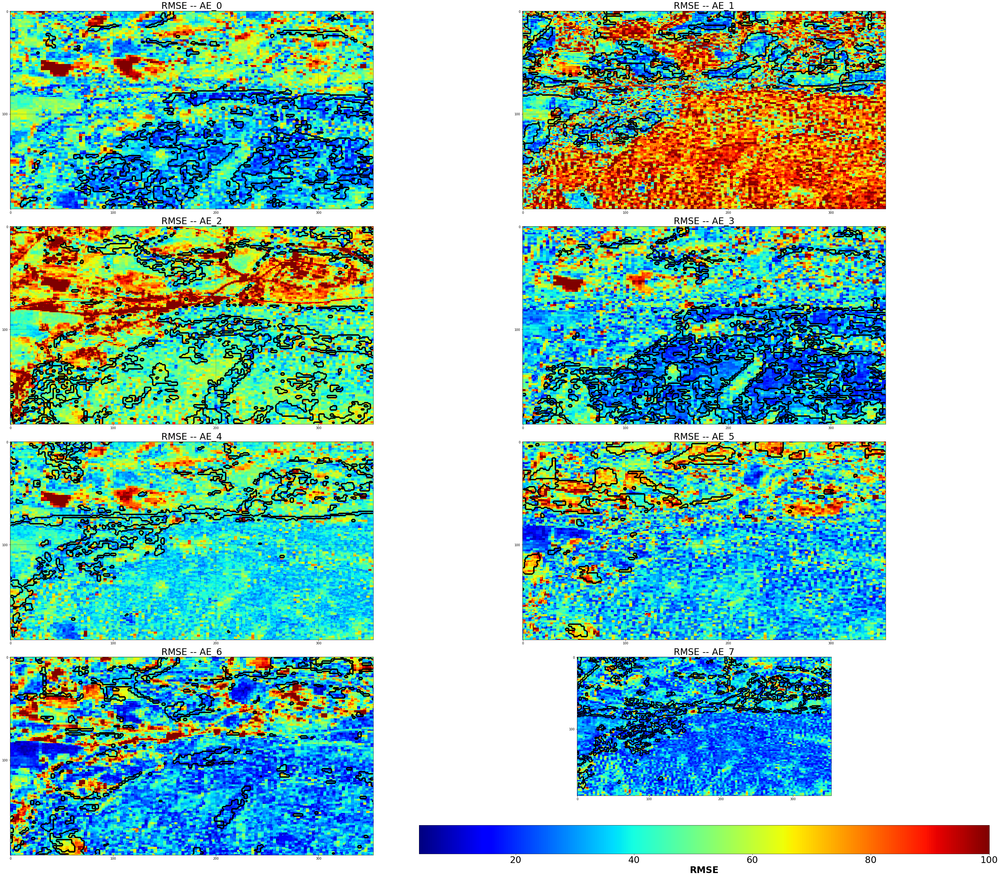

In [42]:
# Prepare subplots
n_figures = n_clusters
n_rows = int(math.ceil((n_figures)**(1/2))) +1
n_cols = int(math.ceil(n_figures/n_rows))
fig, axs = plt.subplots(n_rows, n_cols, figsize= (50,40))
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# RMSE in each subplot: plot error matrices
cm = 'jet'
for ae in range(n_figures):
    mean = error_list[ae]
    cluster = labels==ae
    ax = axs[rows[ae], columns[ae]]
    im = ax.imshow(mean, cmap=cm, vmax=100)
    ax.contour(cluster, colors='black', linewidths=1.5)
    ax.set_xticks(np.arange(mean.shape[1]+1, step=100))
    ax.set_yticks(np.arange(mean.shape[0]+1, step=100))
    ax.grid(color='black', linewidth=0.3)
    ax.set_title(f'RMSE -- AE_{ae}', fontsize=30)

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

# colorbar
cb = plt.colorbar(im, orientation="horizontal", pad=0.15)
cb.set_label(label='RMSE', size=30, weight='bold')
cb.ax.tick_params(labelsize=30)

# save
plt.tight_layout()
#plt.savefig(f'{mf3}/RMSE_all_AE.png', format='png', dpi=300)
plt.show()

**Min Error of All Autoencoders in AOI**

In [57]:
##hyperparameters (visualization)
vmin1= 0
vmax1= 10

-------------------------------------------------------------------------------------------
                                        MINIMUM VALUE OF ERRORS
    ------------------------------------------------------------------------------------------------------


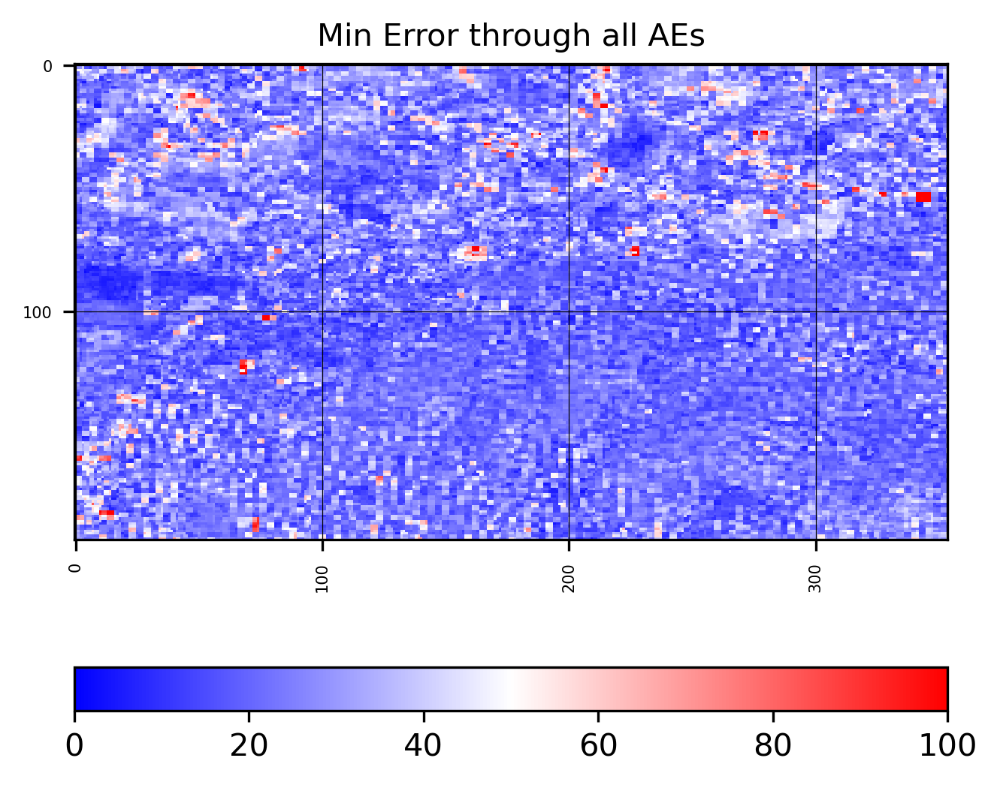

In [44]:
## Min Error of All Autoencoders
print(f'''-------------------------------------------------------------------------------------------
                                        MINIMUM VALUE OF ERRORS
    ------------------------------------------------------------------------------------------------------''')
error = error_list.min(axis=0)
# Plot min error
fig, ax = plt.subplots(figsize=(5,5), dpi=300)
ax = plt.imshow(error, cmap='bwr', interpolation = 'nearest',vmin=vmin1, vmax=vmax1)
plt.xticks(np.arange(error.shape[1]+1, step=100), fontsize=5, rotation=90)
plt.yticks(np.arange(error.shape[0]+1, step=100), fontsize=5, rotation=0)
plt.grid(color='black', linewidth=0.3)
plt.title(f'Min Error through all AEs', fontsize=10)
fig.colorbar(ax, orientation='horizontal')
#plt.savefig(f'{mf3}/min_error.png', format='png', dpi=300)
plt.show()

**REPRESENT MIN ERROR BOUNDING CLUSTERS**

<Figure size 432x288 with 0 Axes>

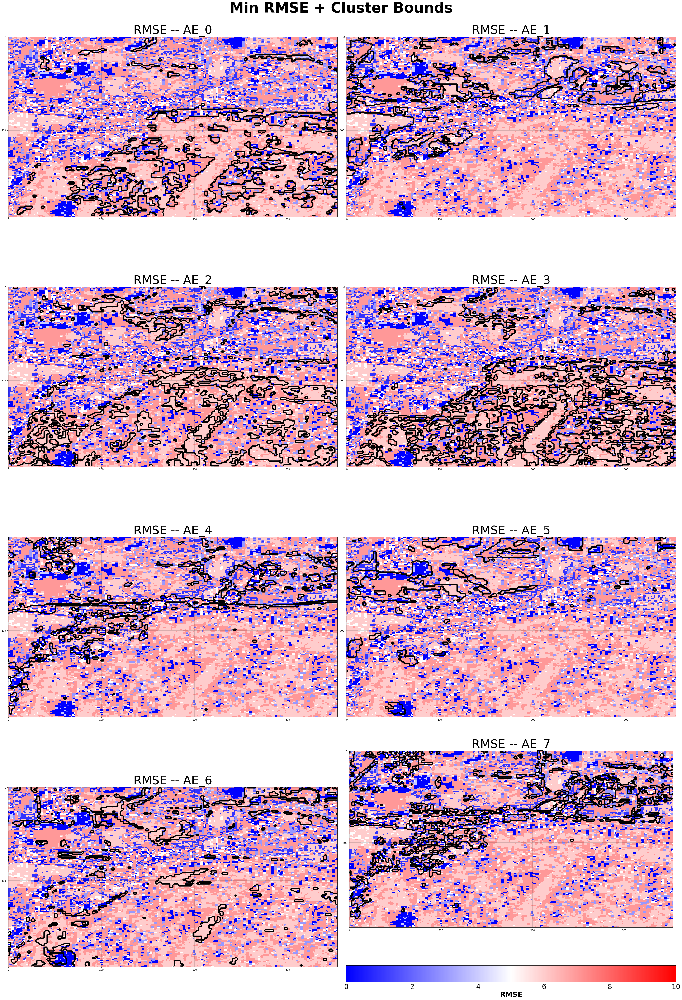

In [58]:
plt.figure()
# Prepare subplots
n_figures = n_clusters
n_rows = 4 
n_cols = 2
rows=[]
columns = []
for row in range(n_rows):
    for col in range(n_cols):
        rows.append(row)
        columns.append(col)

# Subplots and figure title
fig, axs = plt.subplots(n_rows, n_cols, figsize= (40,60))
fig.suptitle(f'Min RMSE + Cluster Bounds', fontsize = 60, fontweight="bold")

# RMSE in each subplot: plot error matrices
cm = 'jet'
for sp in range(n_figures):
    cluster = labels==sp
    ax = axs[rows[sp], columns[sp]]
    im = ax.imshow(error, cmap='bwr', interpolation = 'nearest',vmin=vmin1, vmax=vmax1)
    ax.contour(cluster, colors='black', linewidths=2)
    ax.set_xticks(np.arange(error.shape[1]+1, step=100))
    ax.set_yticks(np.arange(error.shape[0]+1, step=100))
    ax.grid(color='black', linewidth=0.3)
    ax.set_title(f'RMSE -- AE_{sp}', fontsize=50)

# delete empty figures
for image in range(n_figures, n_rows*n_cols):
    axs[rows[image], columns[image]].set_axis_off()

# colorbar
cb = plt.colorbar(im, orientation="horizontal", pad=0.15)
cb.set_label(label='RMSE', size=30, weight='bold')
cb.ax.tick_params(labelsize=30)

# save
fig.subplots_adjust(top=0.9)
plt.tight_layout()
plt.savefig(f'{mf3}/minRMSE_ClusterBounds.png', format='png', dpi=300)
plt.show()

# Reconstruction

**AUTOENCODERS**

In [47]:
# Autoencoder of each pixel
for y in range(testing.shape[1]):
    for x in range(testing.shape[2]):
        for c in range(n_clusters):
            if error[y,x] == error_list[c, y, x]:
                error[y,x] = c
            else:
                pass

<Figure size 432x288 with 0 Axes>

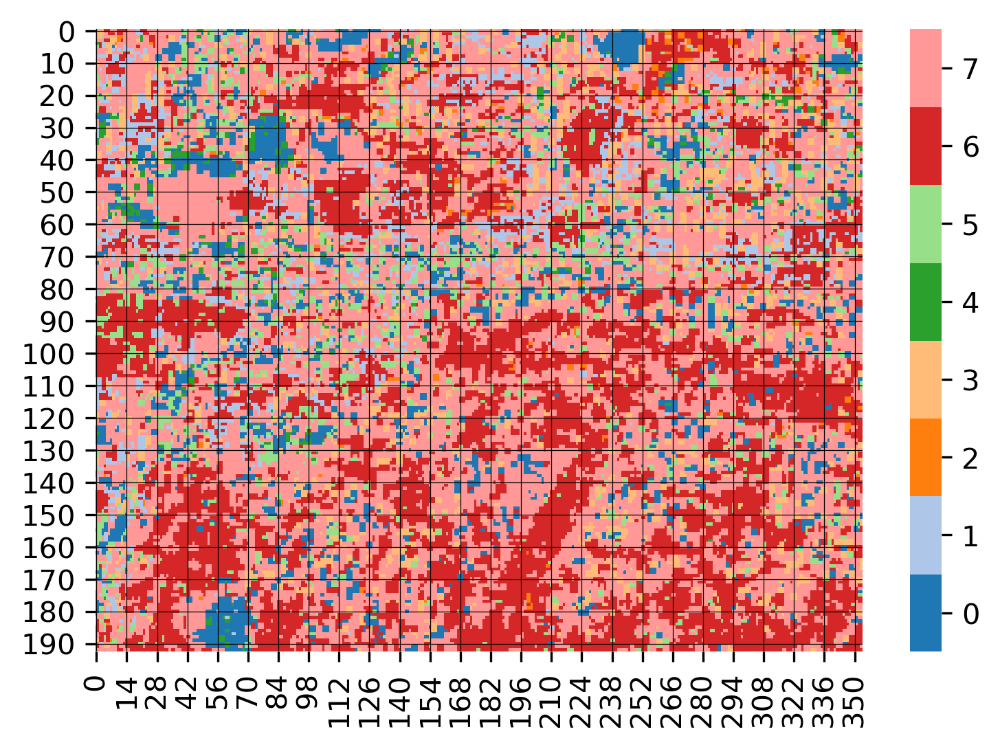

In [48]:
plt.figure()

# discrete colormap (n samples from a given cmap)
cmap = sns.color_palette('tab20', n_clusters) 
fig, ax = plt.subplots(dpi=300) 
ax = sns.heatmap(error, cmap=cmap) 

# modify colorbar:
colorbar = ax.collections[0].colorbar 
r = colorbar.vmax - colorbar.vmin 
colorbar.set_ticks([colorbar.vmin + r / n_clusters * (0.5 + i) for i in range(n_clusters)])
colorbar.set_ticklabels(list(range(n_clusters)))
plt.grid(color='black', linewidth=0.3)

#save and plot
plt.savefig(f'{figures_filepath}/Clusters_Autoencoders.png', format='png', dpi=300)
plt.show()

**TRUE COLOR COMPOSITE**

In [49]:
best_pred = []
for c in range(n_clusters):
    cluster = error == c
    prediction_cluster = prediction[c]
    pred_cluster = cluster * prediction_cluster
    best_pred.append(pred_cluster)
best_pred = np.array(best_pred)
best_pred = np.sum(best_pred, axis = 0)
best_pred.shape

(14, 193, 354)

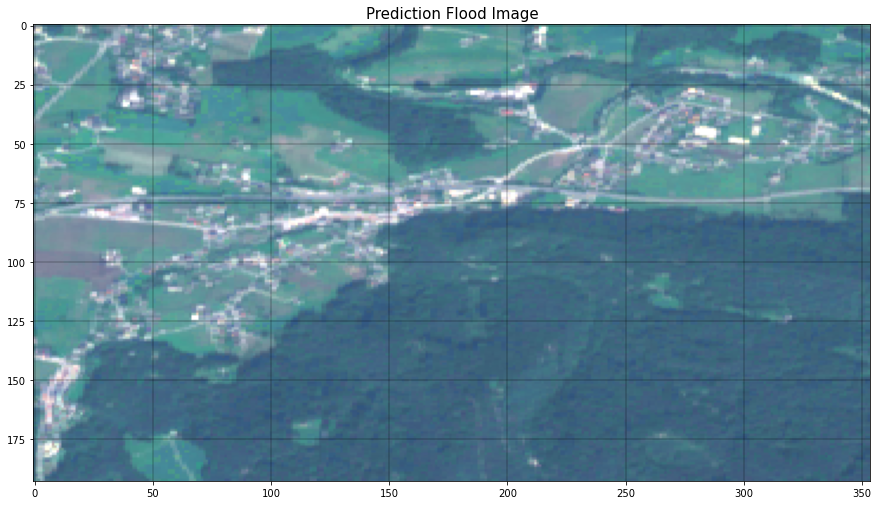

In [50]:
plt.figure(figsize = (15,15))
image = best_pred
img = np.dstack((image[3, ...]/1500, image[2, ...]/1500, image[1, ...]/1500))
img = np.clip(img, 0, 1)
plt.imshow(np.array(img))
plt.grid(color='black', linewidth=0.3)
plt.title(f'Prediction Flood Image', fontsize=15)
plt.savefig(f'{figures_filepath}/reconstruction_TCC.png', format='png', dpi=300)
plt.show()

# End :)